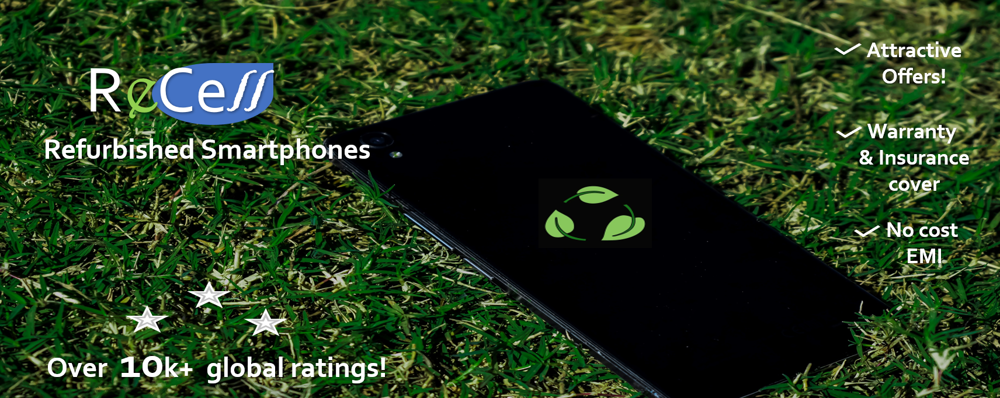

## Context

Buying and selling used phones and tablets used to be something that happened on a handful of online marketplace sites. But the used and refurbished device market has grown considerably over the past decade, and a new IDC (International Data Corporation) forecast predicts that the used phone market would be worth $52.7bn by 2023 with a compound annual growth rate (CAGR) of 13.6% from 2018 to 2023. This growth can be attributed to an uptick in demand for used phones and tablets that offer considerable savings compared with new models.

Refurbished and used devices continue to provide cost-effective alternatives to both consumers and businesses that are looking to save money when purchasing one. There are plenty of other benefits associated with the used device market. Used and refurbished devices can be sold with warranties and can also be insured with proof of purchase. Third-party vendors/platforms, such as Verizon, Amazon, etc., provide attractive offers to customers for refurbished devices. Maximizing the longevity of devices through second-hand trade also reduces their environmental impact and helps in recycling and reducing waste. The impact of the COVID-19 outbreak may further boost this segment as consumers cut back on discretionary spending and buy phones and tablets only for immediate needs.

 

## Objective

The rising potential of this comparatively under-the-radar market fuels the need for an ML-based solution to develop a dynamic pricing strategy for used and refurbished devices. ReCell, a startup aiming to tap the potential in this market, has hired you as a data scientist. They want you to analyze the data provided and build a linear regression model to predict the price of a used phone/tablet and identify factors that significantly influence it.

 

## Data Description

The data contains the different attributes of used/refurbished phones and tablets. The data was collected in the year 2021. The detailed data dictionary is given below.

## Data Dictionary

brand_name: Name of manufacturing brand

os: OS on which the device runs

screen_size: Size of the screen in cm

4g: Whether 4G is available or not

5g: Whether 5G is available or not

main_camera_mp: Resolution of the rear camera in megapixels

selfie_camera_mp: Resolution of the front camera in megapixels

int_memory: Amount of internal memory (ROM) in GB

ram: Amount of RAM in GB

battery: Energy capacity of the device battery in mAh

weight: Weight of the device in grams

release_year: Year when the device model was released

days_used: Number of days the used/refurbished device has been used

normalized_new_price: Normalized price of a new device of the same model in 
euros

normalized_used_price: Normalized price of the used/refurbished device in euros

#**Import the necessary libraries**

In [ ]:
# Libraries to help with reading and manipulating data
import numpy as np
import pandas as pd

# Libraries to help with data visualization
import matplotlib.pyplot as plt
import seaborn as sns

sns.set()

# split the data into train and test
from sklearn.model_selection import train_test_split

# to build linear regression_model
import statsmodels.api as sm

# to check model performance
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


##**Import the dataset**

In [ ]:
used = pd.read_csv("used_device_data.csv")


##**Data overview**

In [ ]:
used.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3454 entries, 0 to 3453
Data columns (total 15 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   brand_name             3454 non-null   object 
 1   os                     3454 non-null   object 
 2   screen_size            3454 non-null   float64
 3   4g                     3454 non-null   object 
 4   5g                     3454 non-null   object 
 5   main_camera_mp         3275 non-null   float64
 6   selfie_camera_mp       3452 non-null   float64
 7   int_memory             3450 non-null   float64
 8   ram                    3450 non-null   float64
 9   battery                3448 non-null   float64
 10  weight                 3447 non-null   float64
 11  release_year           3454 non-null   int64  
 12  days_used              3454 non-null   int64  
 13  normalized_used_price  3454 non-null   float64
 14  normalized_new_price   3454 non-null   float64
dtypes: f

We have 9 floating variables, 4 object variables, and 2 integer variables. Generally speaking, we can say that our data is composed by 11 numerical variables and 4 categorical ones. 

In [ ]:
used.describe(include="all").T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
brand_name,3454,34,Others,502,NaN,NaN,NaN,NaN,NaN,NaN,NaN
os,3454,4,Android,3214,NaN,NaN,NaN,NaN,NaN,NaN,NaN
screen_size,3454.0,NaN,NaN,NaN,13.713115,3.80528,5.08,12.7,12.83,15.34,30.71
4g,3454,2,yes,2335,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5g,3454,2,no,3302,NaN,NaN,NaN,NaN,NaN,NaN,NaN
main_camera_mp,3275.0,NaN,NaN,NaN,9.460208,4.815461,0.08,5.0,8.0,13.0,48.0
selfie_camera_mp,3452.0,NaN,NaN,NaN,6.554229,6.970372,0.0,2.0,5.0,8.0,32.0
int_memory,3450.0,NaN,NaN,NaN,54.573099,84.972371,0.01,16.0,32.0,64.0,1024.0
ram,3450.0,NaN,NaN,NaN,4.036122,1.365105,0.02,4.0,4.0,4.0,12.0
battery,3448.0,NaN,NaN,NaN,3133.402697,1299.682844,500.0,2100.0,3000.0,4000.0,9720.0


##**Exploratory Data Analysis**

In [ ]:
!pip install pandas-profiling==3.0.0 ##Installatio of the pandas profiling library.

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 248 kB 5.1 MB/s 
     |████████████████████████████████| 3.1 MB 33.8 MB/s 
     |████████████████████████████████| 596 kB 55.2 MB/s 
     |████████████████████████████████| 62 kB 1.3 MB/s 
     |████████████████████████████████| 102 kB 37.7 MB/s 
     |████████████████████████████████| 690 kB 42.2 MB/s 
     |████████████████████████████████| 355 kB 55.9 MB/s 
     |████████████████████████████████| 812 kB 50.3 MB/s 
     |████████████████████████████████| 38.1 MB 1.2 MB/s 
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27098 sha256=5d7cdbe582584695d12ee1e8f541e7e0a64fc6bd606c8d9f625df5b5d8bb3783
  Stored in directory: /root/.cache/pip/wheels/70/e1/52/5b14d250ba868768823940c3229e9950d201a26d0bd3ee8655
  Created wheel for imagehash: filename=ImageHash-4.2.1-py2.py3-none-any.whl size=295206 sha256=70ff37fded13a60dd81439bfd9

In [ ]:
from pandas_profiling import ProfileReport #Import the tool

In [ ]:
report = ProfileReport(used, title = "Data exploration") #Report generation

In [ ]:
report.to_notebook_iframe() #Deploy the report on the web

Summarize dataset:   0%|          | 0/28 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
report.to_file("Report.html") #Generate a html file for the report

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
used.groupby("ram")["brand_name"].value_counts()

ram    brand_name
0.02   Nokia         18
0.03   Nokia         17
0.25   Others        24
       Celkon        21
       Micromax      10
                     ..
12.00  Oppo           4
       Huawei         2
       Motorola       2
       OnePlus        2
       Xiaomi         1
Name: brand_name, Length: 143, dtype: int64

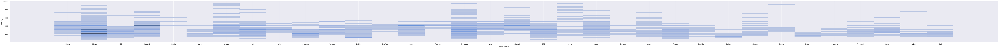

In [ ]:
#create scatterplot of battery vs. brand
sns.displot(data=used,x="brand_name",y="battery",kind="hist",height=5,aspect=20)


In [ ]:
used[used["screen_size"]>6.0].count()

brand_name               3362
os                       3362
screen_size              3362
4g                       3362
5g                       3362
main_camera_mp           3183
selfie_camera_mp         3360
int_memory               3361
ram                      3361
battery                  3358
weight                   3355
release_year             3362
days_used                3362
normalized_used_price    3362
normalized_new_price     3362
dtype: int64

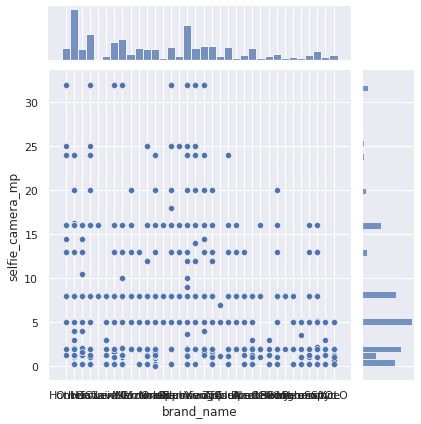

In [ ]:
sns.jointplot(data=used,x="brand_name",y="selfie_camera_mp")

###**Questions**

Questions:

####**1.-What does the distribution of normalized used device prices look like?**

It looks like a normal distributions with no skewing bias.


####**2.-What percentage of the used device market is dominated by Android devices?**

An astonishing 93 % of the device market is dominated by android.

####**3.-The amount of RAM is important for the smooth functioning of a device. How does the amount of RAM vary with the brand?**

Nokia tends to have a smaller RAM while Motorola and Huawei tend to have a larger RAM size. 


####**4.-A large battery often increases a device's weight, making it feel uncomfortable in the hands. How does the weight vary for phones and tablets offering large batteries (more than 4500 mAh)?**

In general, every brand has extreme values regarding the battery size, but the brands that have the larger battery sizes overall would be Apple, Google and Samsung. 

####**5.-Bigger screens are desirable for entertainment purposes as they offer a better viewing experience. How many phones and tablets are available across different brands with a screen size larger than 6 inches?**

About 3362 cell phones have screens wider tha 6 inches, making it the vast majority of the population. 

####**6.-A lot of devices nowadays offer great selfie cameras, allowing us to capture our favorite moments with loved ones. What is the distribution of devices offering greater than 8MP selfie cameras across brands?**

The distribution of selfie cameras accross brands seems to be skewed to the left heavily, so at least we can infere that it does not follow a normal distribution. The amount of cell phones with a greater than 8MP cameras is rather small in comparison to the ones with cameras of lesser qualities. 

####**7.-Which attributes are highly correlated with the normalized price of a used device?**

The normalized price of a new device, the screen sice, the selfie and main camera mp, and the battery.

##**Data preprocessing**

In [ ]:
used.isnull().any

<bound method NDFrame._add_numeric_operations.<locals>.any of       brand_name     os  screen_size     4g     5g  main_camera_mp  \
0          False  False        False  False  False           False   
1          False  False        False  False  False           False   
2          False  False        False  False  False           False   
3          False  False        False  False  False           False   
4          False  False        False  False  False           False   
...          ...    ...          ...    ...    ...             ...   
3449       False  False        False  False  False            True   
3450       False  False        False  False  False           False   
3451       False  False        False  False  False           False   
3452       False  False        False  False  False           False   
3453       False  False        False  False  False           False   

      selfie_camera_mp  int_memory    ram  battery  weight  release_year  \
0                Fals

There are missing data in some rows. Let's identify how many of them. 

In [17]:
used.isnull().values.any()

True

In [ ]:
used.isnull().sum()

brand_name                 0
os                         0
screen_size                0
4g                         0
5g                         0
main_camera_mp           179
selfie_camera_mp           2
int_memory                 4
ram                        4
battery                    6
weight                     7
release_year               0
days_used                  0
normalized_used_price      0
normalized_new_price       0
dtype: int64

Because the missing total number of values is less than 10 % of the observations, we can erase those values safely. 

In [18]:
df = used.dropna(axis=0)

In [19]:
df.isnull().values.any()

False

In [20]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
screen_size,3253.0,13.617476,3.851520,5.080000,12.700000,12.830000,15.320000,30.710000
main_camera_mp,3253.0,9.476354,4.802200,0.080000,5.000000,8.000000,13.000000,48.000000
selfie_camera_mp,3253.0,6.093790,6.599580,0.000000,2.000000,5.000000,8.000000,32.000000
int_memory,3253.0,52.098632,85.442242,0.010000,16.000000,32.000000,64.000000,1024.000000
ram,3253.0,3.962960,1.225895,0.020000,4.000000,4.000000,4.000000,12.000000
battery,3253.0,3074.926990,1296.957619,500.000000,2100.000000,3000.000000,3950.000000,9720.000000
weight,3253.0,182.493637,90.359810,69.000000,140.450000,158.000000,182.000000,855.000000
release_year,3253.0,2015.766370,2.187719,2013.000000,2014.000000,2015.000000,2018.000000,2020.000000
days_used,3253.0,695.695358,235.454084,91.000000,564.000000,705.000000,879.000000,1094.000000
normalized_used_price,3253.0,4.342386,0.579414,1.536867,4.019262,4.377642,4.725616,6.619433


In [21]:
df.duplicated().sum

<bound method NDFrame._add_numeric_operations.<locals>.sum of 0       False
1       False
2       False
3       False
4       False
        ...  
3447    False
3450    False
3451    False
3452    False
3453    False
Length: 3253, dtype: bool>

There are no duplicated values nor missing values. Now, we will do a new exploratory data analysis and check for outliers before building our model.

# **Exploratory Data Analysis II**

In [25]:
reportII = ProfileReport(df, title = "Data exploration II") #Report generation

In [26]:
reportII.to_notebook_iframe() #Deploy the report on the web

Summarize dataset:   0%|          | 0/29 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [28]:
reportII.to_file("ReportII.html") #Generate a html file for the report

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

As we can see in the correlation matrix, the variables that are most correlated with the price of a used device remain the same after quitting the missing and repeated values from our analysis. Meaning that removing those rows didn't affect our data. Now it's time to build up our model and train it to perfection. 

# **Model Building: Linear Regression**

In [86]:
x = df[["normalized_new_price","screen_size","battery","selfie_camera_mp","main_camera_mp","ram"]] #Entry variable 
y = df["normalized_used_price"] #Variable de salida

In [87]:
from sklearn.model_selection import train_test_split

In [88]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.2, random_state = 0, shuffle = True ) 

In [89]:
print(x_test) 

      normalized_new_price  screen_size  battery  selfie_camera_mp  \
1973              5.010635        12.88   4000.0               5.0   
1418              5.386237        12.70   2000.0               8.0   
1959              4.228438        10.16   1560.0               0.3   
1449              5.005288        12.70   2900.0               5.0   
377               5.435990        16.59   4000.0              16.0   
...                    ...          ...      ...               ...   
2251              5.135798        12.70   2200.0               0.3   
535               5.637821        12.93   3400.0               2.0   
1950              5.297117        12.88   3000.0               5.0   
799               5.668224        10.24   1500.0               2.0   
1229              5.524137        12.70   2600.0               5.0   

      main_camera_mp  ram  
1973            13.0  4.0  
1418            16.0  4.0  
1959             2.0  4.0  
1449            13.0  4.0  
377              2.

In [90]:
from sklearn.linear_model import LinearRegression #Librería para el modelo de regresión

In [91]:
model = LinearRegression()

In [92]:
model.fit(x_train,y_train)

LinearRegression()

In [93]:
columns_x = ["Normalized_new_price","main_camera_mp","ram","screen_size","battery","selfie_camera_mp"]

In [94]:
coefficients = pd.DataFrame(model.coef_, columns_x, columns=["Coeficientes"])
coefficients

,Coeficientes
Normalized_new_price,0.422816
main_camera_mp,0.040119
ram,0.000019
screen_size,0.016605
battery,0.022546
selfie_camera_mp,0.017407


In [95]:
y_predict = model.predict(x_test) #Predict the test values

In [96]:
Test = pd.DataFrame({"Real Value": y_test, "Prediction Value": y_predict, "Difference": y_test - y_predict})
Test

,Real Value,Prediction Value,Difference
1973,4.369068,4.301118,0.067950
1418,4.482437,4.531363,-0.048925
1959,3.640214,3.487884,0.152330
1449,4.377265,4.270297,0.106968
377,4.314015,4.564450,-0.250435
...,...,...,...
2251,4.070905,4.053486,0.017419
535,4.742756,4.394122,0.348634
1950,4.195245,4.402848,-0.207603
799,4.594210,4.262200,0.332010


### **Data Preparation for Modeling**

In [98]:
model = sm.OLS(y_train, x_train).fit()
print(model.summary())

                                  OLS Regression Results                                  
Dep. Variable:     normalized_used_price   R-squared (uncentered):                   0.996
Model:                               OLS   Adj. R-squared (uncentered):              0.996
Method:                    Least Squares   F-statistic:                          1.119e+05
Date:                   Sat, 09 Jul 2022   Prob (F-statistic):                        0.00
Time:                           04:38:02   Log-Likelihood:                         -293.39
No. Observations:                   2602   AIC:                                      598.8
Df Residuals:                       2596   BIC:                                      634.0
Df Model:                              6                                                  
Covariance Type:               nonrobust                                                  
                           coef    std err          t      P>|t|      [0.025      0.975]
-

###**Main insights from the model:**

-The variable "Ram" is not statistically significant because its P value is less than its test value. 

-There is risk of multicollinearity in th model according to the condition coefficient. 

-With a kurtosis of 3 we can infere the model is normally distributed. 

-The Durbin Watson has a higher score than the P value of 0.05. Meaning that there is no independence in the model. 

-The Jarque Bera prob coefficient has a lower score than the P value of 0.05. Meaning that the model has a normal distribution. 


In [100]:
# initial list of columns
predictors = x_train.copy()
cols = predictors.columns.tolist()

# setting an initial max p-value
max_p_value = 1

while len(cols) > 0:
    # defining the train set
    x_train_aux = predictors[cols]

    # fitting the model
    model = sm.OLS(y_train, x_train_aux).fit()

    # getting the p-values and the maximum p-value
    p_values = model.pvalues
    max_p_value = max(p_values)

    # name of the variable with maximum p-value
    feature_with_p_max = p_values.idxmax()

    if max_p_value > 0.05:
        cols.remove(feature_with_p_max)
    else:
        break

selected_features = cols
print(selected_features)

['normalized_new_price', 'screen_size', 'battery', 'selfie_camera_mp', 'main_camera_mp']


In [101]:
x_train1 = x_train[selected_features]
x_test1 = x_test[selected_features]

In [125]:
mod2 = sm.OLS(y_train, x_train1).fit()
print(mod2.summary())

                                  OLS Regression Results                                  
Dep. Variable:     normalized_used_price   R-squared (uncentered):                   0.996
Model:                               OLS   Adj. R-squared (uncentered):              0.996
Method:                    Least Squares   F-statistic:                          1.342e+05
Date:                   Sat, 09 Jul 2022   Prob (F-statistic):                        0.00
Time:                           04:59:50   Log-Likelihood:                         -294.82
No. Observations:                   2602   AIC:                                      599.6
Df Residuals:                       2597   BIC:                                      629.0
Df Model:                              5                                                  
Covariance Type:               nonrobust                                                  
                           coef    std err          t      P>|t|      [0.025      0.975]
-

# ###**Assumptions:**

Although now all the variables are statistically significant, there are still some conditions we need to check and correct for our final model.

*Multicollinearity*

In [109]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

X1 = df[["normalized_new_price","screen_size","battery","selfie_camera_mp","main_camera_mp"]]

vif_info = pd.DataFrame()
vif_info['VIF'] = [variance_inflation_factor(X.values, i) for i in range(X1.shape[1])]
vif_info['Column'] = X1.columns
vif_info.sort_values('VIF', ascending=False)


,VIF,Column
1,41.788576,screen_size
0,39.538167,normalized_new_price
2,20.608805,battery
4,7.278067,main_camera_mp
3,2.611280,selfie_camera_mp


There are 4 variables with a VIF higher than 5, we need to drop them so that our model won't be biased with multicollinearity. Although, we can first drop the first three and check if the remaining two still have a high VIF value.

In [114]:
X2 = X1.drop(['screen_size', 'normalized_new_price', 'battery'], axis=1)

vif_info = pd.DataFrame()
vif_info['VIF'] = [variance_inflation_factor(X2.values, i) for i in range(X2.shape[1])]
vif_info['Column'] = X2.columns
vif_info.sort_values('VIF', ascending=False)

,VIF,Column
0,2.265904,selfie_camera_mp
1,2.265904,main_camera_mp


Now there are no variables that have a high VIF variable, up to now it is the most efficient model we can build. 

In [142]:
X2

,selfie_camera_mp,main_camera_mp
0,5.0,13.0
1,16.0,13.0
2,8.0,13.0
3,8.0,13.0
4,8.0,13.0
...,...,...
3447,7.0,8.0
3450,8.0,13.0
3451,5.0,13.0
3452,5.0,13.0


In [143]:
X2_train, X2_test, y_train, y_test = train_test_split(x, y, test_size = 0.2, random_state = 0, shuffle = True ) 

In [144]:
print(X2_test)

      normalized_new_price  screen_size  battery  selfie_camera_mp  \
1973              5.010635        12.88   4000.0               5.0   
1418              5.386237        12.70   2000.0               8.0   
1959              4.228438        10.16   1560.0               0.3   
1449              5.005288        12.70   2900.0               5.0   
377               5.435990        16.59   4000.0              16.0   
...                    ...          ...      ...               ...   
2251              5.135798        12.70   2200.0               0.3   
535               5.637821        12.93   3400.0               2.0   
1950              5.297117        12.88   3000.0               5.0   
799               5.668224        10.24   1500.0               2.0   
1229              5.524137        12.70   2600.0               5.0   

      main_camera_mp  ram  
1973            13.0  4.0  
1418            16.0  4.0  
1959             2.0  4.0  
1449            13.0  4.0  
377              2.

In [152]:
x3_test = x2_test[["selfie_camera_mp","main_camera_mp"]]

In [153]:
x2_train

,normalized_new_price,screen_size,battery,selfie_camera_mp,main_camera_mp,ram
1744,5.477969,10.34,2440.0,1.3,13.00,4.0
1510,5.136622,20.32,4250.0,5.0,8.00,4.0
2557,5.245760,17.78,4000.0,1.3,3.15,4.0
1332,5.011901,17.78,4100.0,2.0,2.00,4.0
2451,4.858183,17.78,4000.0,2.0,5.00,4.0
...,...,...,...,...,...,...
850,5.738538,15.24,3500.0,8.0,24.00,4.0
922,5.561912,12.70,3120.0,5.0,13.00,4.0
1743,5.291494,10.29,2440.0,0.3,5.00,4.0
2719,5.239681,10.29,2330.0,0.3,5.00,4.0


In [154]:
x3_train = x2_train[["selfie_camera_mp","main_camera_mp"]]

In [134]:
model2 = LinearRegression()

In [156]:
model2 = sm.OLS(y_train, x3_train).fit()
print(model2.summary())

                                  OLS Regression Results                                  
Dep. Variable:     normalized_used_price   R-squared (uncentered):                   0.851
Model:                               OLS   Adj. R-squared (uncentered):              0.850
Method:                    Least Squares   F-statistic:                              7401.
Date:                   Sat, 09 Jul 2022   Prob (F-statistic):                        0.00
Time:                           05:13:51   Log-Likelihood:                         -5052.4
No. Observations:                   2602   AIC:                                  1.011e+04
Df Residuals:                       2600   BIC:                                  1.012e+04
Df Model:                              2                                                  
Covariance Type:               nonrobust                                                  
                       coef    std err          t      P>|t|      [0.025      0.975]
-----

With the new model, there is no risk of multicolinearity, all coefficients are statistically significant and the R squared statistic increases. Meaning that the model now explains a higher percentage of the observations. The assumption of normality is safely assumed with a prob JB of 0 and a Kurtosis higher than the p value of 0.05. The Durbin Watson statistic is the last part of the model we want to check, to confirm that the model is homoscedastic. 

###*Constant variance test*

In [164]:
df_pred = x3_train[["selfie_camera_mp",	"main_camera_mp"]]

df_pred["Actual Values"] = y_train  # actual values
df_pred["Fitted Values"] = model2.fittedvalues  # predicted values
df_pred["Residuals"] = model2.resid  # residuals

df_pred.head()

,selfie_camera_mp,main_camera_mp,Actual Values,Fitted Values,Residuals
1744,1.3,13.00,4.261975,4.632595,-0.370619
1510,5.0,8.00,4.712858,3.048822,1.664036
2557,1.3,3.15,4.215382,1.168948,3.046434
1332,2.0,2.00,4.097506,0.797562,3.299945
2451,2.0,5.00,4.514917,1.852479,2.662438


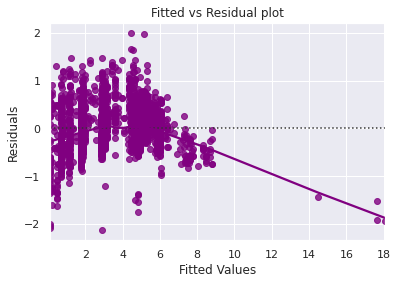

In [166]:
sns.residplot(
    data=df_pred, x="Fitted Values", y="Residuals", color="purple", lowess=True
)
plt.xlabel("Fitted Values")
plt.ylabel("Residuals")
plt.title("Fitted vs Residual plot")
plt.show()

There is no pattern in the plot of resifual variables, therfore we can assume linearity of the model.

In [171]:
import statsmodels.stats.api as sms
from statsmodels.compat import lzip

name = ["F statistic", "p-value"]
test = sms.het_goldfeldquandt(df_pred["Residuals"], x3_train)
lzip(name, test)

[('F statistic', 1.0111746806181405), ('p-value', 0.42065386379115066)]

Since p-value > 0.05, we can say that the residuals are homoscedastic. So, this assumption is satisfied

#**Final Model**

In [172]:
model2 = sm.OLS(y_train, x3_train).fit()
print(model2.summary())

                                  OLS Regression Results                                  
Dep. Variable:     normalized_used_price   R-squared (uncentered):                   0.851
Model:                               OLS   Adj. R-squared (uncentered):              0.850
Method:                    Least Squares   F-statistic:                              7401.
Date:                   Sat, 09 Jul 2022   Prob (F-statistic):                        0.00
Time:                           05:33:45   Log-Likelihood:                         -5052.4
No. Observations:                   2602   AIC:                                  1.011e+04
Df Residuals:                       2600   BIC:                                  1.012e+04
Df Model:                              2                                                  
Covariance Type:               nonrobust                                                  
                       coef    std err          t      P>|t|      [0.025      0.975]
-----

In summary we can say that the two variables we analyzed are statistically significant and the model can explain 85 % of the actual values. Making it a relatively good model for predicting the price of used cell phones. 

##Additional insights and recommendations

We strongly reccomend the companies to concentrate developing better quality cell phones overall, but they should focus specieally on selfie and main cameras since those are apparently the most influential variables on the price of their cell phones.